In [1]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import matplotlib.pyplot as plt
%matplotlib inline

import cv2
import numpy as np
import sys
sys.path.insert(0, '../utility')

import iman2

### Load image

(2287, 440, 3)

<Figure size 1440x2880 with 0 Axes>

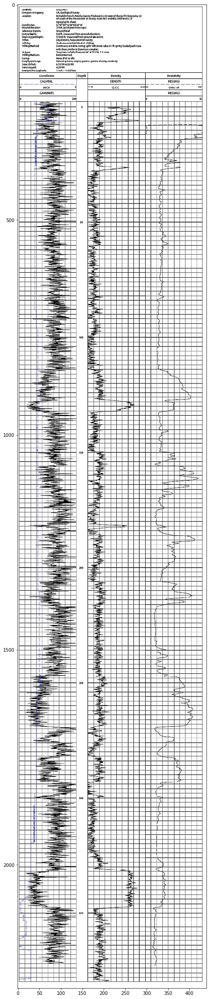

In [2]:
src = cv2.imread('../data/fieldprint.jpg'); src.shape
###
# OpenCV uses BGR as its default colour order for images, matplotlib uses RGB. 
# When you display an image loaded with OpenCv in matplotlib the channels will be back to front.
# The easiest way of fixing this is to use OpenCV to explicitly convert it back to RGB
###

plt.figure(figsize=(20,40))
_ = plt.imshow(src)

### BGR to Gray scale

In [3]:
# Transform source image to gray if it is not already
if len(src.shape) != 2:
    gray = cv2.cvtColor(src, cv2.COLOR_BGR2GRAY)
else:
    gray = src

<Figure size 1440x2880 with 0 Axes>

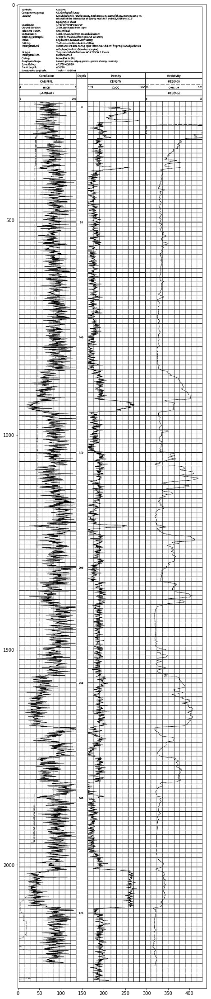

In [4]:
plt.figure(figsize=(20,40))
_ = plt.imshow(gray, cmap='gray')

### Gray scale to Binary

In [5]:
# Apply adaptiveThreshold at the bitwise_not of gray, notice the ~ symbol
gray = cv2.bitwise_not(gray)
bw = cv2.adaptiveThreshold(gray, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 15, -2)

<Figure size 1440x2880 with 0 Axes>

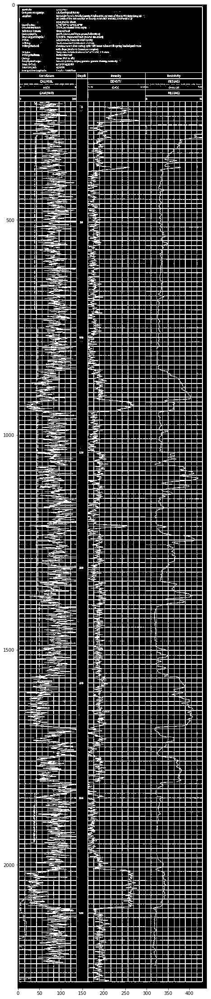

In [6]:
plt.figure(figsize=(20,40))
_ = plt.imshow(bw, cmap='gray')

### Append image to itself to make an image with 2 grid areas

(4574, 440)

<Figure size 1440x2880 with 0 Axes>

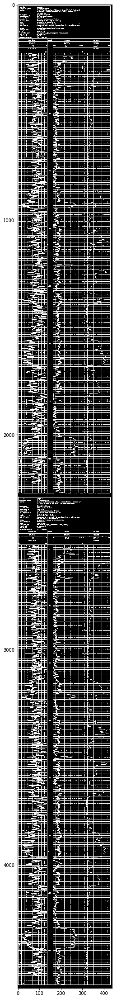

In [7]:
bw2 = np.append(bw, bw, axis=0); bw2.shape

plt.figure(figsize=(20,40))
_ = plt.imshow(bw2, cmap='gray')

### Get Contour

<Figure size 2160x5760 with 0 Axes>

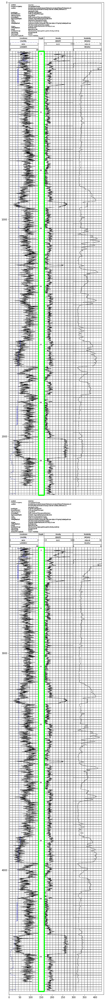

In [8]:
im2, contours, hierarchy = cv2.findContours(bw2, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)

img = bw2
w_min = 10
w_max = 50
h_min = 1000
h_max = 3000

img = np.append(src, src, axis=0)
img_out = iman2.detect_rectangles2(img, contours, w_min, w_max, h_min, h_max)

plt.figure(figsize=(30,80))
_ = plt.imshow(img_out, cmap='gray')

<Figure size 2160x5760 with 0 Axes>

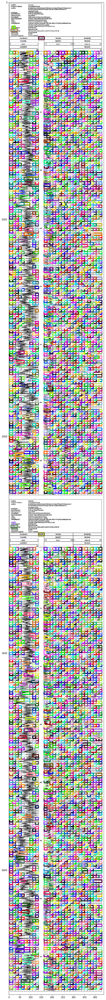

In [10]:
im2, contours, hierarchy = cv2.findContours(bw2, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)

img = bw2
w_min = 10
w_max = 50
h_min = 10
h_max = 30

img = np.append(src, src, axis=0)
img_out = iman2.detect_rectangles2(img, contours, w_min, w_max, h_min, h_max, colour='random')

plt.figure(figsize=(30,80))
_ = plt.imshow(img_out, cmap='gray')

<Figure size 2160x5760 with 0 Axes>

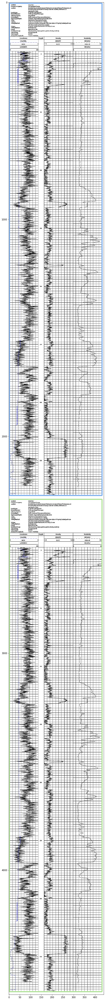

In [11]:
im2, contours, hierarchy = cv2.findContours(bw2, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

img = bw2
w_min = 20
w_max = 500
h_min = 2000
h_max = 3000

img = np.append(src, src, axis=0)
img_out = iman2.detect_rectangles2(img, contours, w_min, w_max, h_min, h_max, colour='random')

plt.figure(figsize=(30,80))
_ = plt.imshow(img_out, cmap='gray')

<Figure size 2160x5760 with 0 Axes>

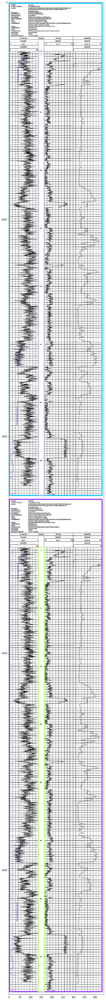

In [13]:
im2, contours, hierarchy = cv2.findContours(bw2, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

img = bw2
w_min = 20
w_max = 500
h_min = 2000
h_max = 2500

img = np.append(src, src, axis=0)
img_out = iman2.detect_rectangles2(img, contours, w_min, w_max, h_min, h_max, colour='random')

plt.figure(figsize=(30,80))
_ = plt.imshow(img_out, cmap='gray')

In [ ]:
len(contours)

<Figure size 2160x5760 with 0 Axes>

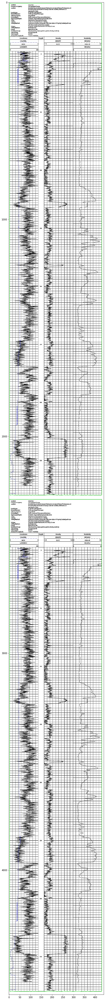

In [14]:
img = np.append(src, src, axis=0)

im2, contours, hierarchy = cv2.findContours(bw2, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
img_contour = cv2.drawContours(img, contours, -1, (0,255,0), 1)

plt.figure(figsize=(30,80))
_ = plt.imshow(img_contour, cmap='gray')

<Figure size 2160x5760 with 0 Axes>

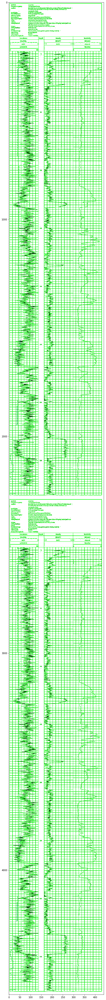

In [15]:
img = np.append(src, src, axis=0)

im2, contours, hierarchy = cv2.findContours(bw2, cv2.RETR_LIST, cv2.CHAIN_APPROX_SIMPLE)
img_contour = cv2.drawContours(img, contours, -1, (0,255,0), 1)

plt.figure(figsize=(30,80))
_ = plt.imshow(img_contour, cmap='gray')

<Figure size 2160x5760 with 0 Axes>

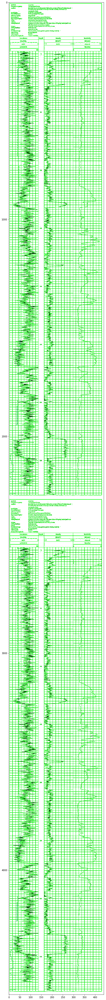

In [16]:
img = np.append(src, src, axis=0)

im2, contours, hierarchy = cv2.findContours(bw2, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)
img_contour = cv2.drawContours(img, contours, -1, (0,255,0), 1)

plt.figure(figsize=(30,80))
_ = plt.imshow(img_contour, cmap='gray')

### Display

## Putting all together